# Tutorial X: Stochastic simulations as a tool to study evolution.

© 2017 Griffin Chure & Manuel Razo. This work is licensed under a [Creative Commons Attribution License CC-BY 4.0](https://creativecommons.org/licenses/by/4.0/). All code contained herein is licensed under an [MIT license](https://opensource.org/licenses/MIT)   

In [1]:
# For scientific computing
import numpy as np

# For plotting
import matplotlib.pyplot as plt
import seaborn as sns

# Set the plotting environment.
%matplotlib inline
sns.set_context('notebook')
sns.set_style('darkgrid')

# This enables SVG graphics inline (only use with static plots (non-Bokeh))
%config InlineBackend.figure_format = 'svg'

--- 

In this tutorial, we will cover the basics of writing stochastic simulations and their application to biological phenomena ranging from the diffusion of molecules to genetic drift in populations.

## What is a stochastic simulation? 

In science, we are often more interested in the distribution of a set of outcomes rather than a single event. This may be the probability distribution of a molecule diffusing a specific distance as a function of time, the distribution of mRNA molecules per cell produced from a constitutively expressing promoter, or the probability distribution of a model parameter given a collection of data. [Stochastic simulations](https://en.wikipedia.org/wiki/Stochastic_simulation) allow us to generate a series of simulations of a system in which one step (such as the direction a molecule will diffuse) is governed by random chance. These simulations often boil down to flipping a coin to dictate if said step will occur or not. 

Of course, sitting in your office chair flipping a US quarter over and over again is not how one should do a simulation. To get a sense of the probability distribution of some outcome, we often have to simulate the process thousands of times. This means that we need to know how to make our computers do the heavy lifting. 

It's often easy to forget just how powerful modern computers can be. What once required a serious computational cluster only twenty years ago can now be done on a 10 mm thick compartment made of rose-gold colored aluminium. In the following exercise, we will demonstate how you can learn about the behavior of biological systems from the comfort of your laptop in only half a screen of code. 

## Example I: The Random Walk 

Think of a molecule that moves either left or right with equal step probabilities at each subsequent time point. We can decide whether to walk left or right by flipping a coin and seeing if it comes up 'heads' or 'tails'. 

In [2]:
# Flip a coin three times.
flip_1 = np.random.rand()
flip_2 = np.random.rand()
flip_3 = np.random.rand()
print(flip_1, flip_2, flip_3)

0.2899256323994802 0.8513064893691029 0.08315635834491264


Note that this will change every time that we run the code cell. How do we convert this to a 'heads' and 'tails' readout? We can assume that this is a totally fair coin. This means that the probability of getting "heads" to come up $P_H$ is the same as flipping a "tails" $P_T$ such that $P_H + P_T = 1$. This means that for a fair coin, $P_H = P_T = 0.5$. To convert our coin flips above, we simply have to test if the flip is above or below $0.5$. If it is below, we'll say that the coin was flipped "heads", otherwise, it is "tails".

In [3]:
# Convert our coinflips to heads and tails.
flips = [flip_1, flip_2, flip_3]
for flip in flips:
    if flip < 0.5:
        print("Heads")
    else: 
        print("Tails")

Heads
Tails
Heads


Now imagine that we wanted to flip the coin one thousand times. Obviously, we shouldn't write out a thousand variables and then loop through them. We could go through a loop for one thousand times and flip a coin at each step or flip one thousand coins at once and store them in an array. In the interest of simplicity, we'll go with option one. Let's flip a coin one thousand times and compute the probability of getting "heads".

In [4]:
# Test that our coin flipping algorithm is fair.
n_flips = 1000  # That's a lot of flips!
p = 0.5  # Our anticipated probability of a heads.

# Flip the coin n_flips times.
flips = np.random.rand(n_flips)

# Compute the number of heads.
heads_or_tails = flips < p  # Will result in a True (1.0) if heads.
n_heads = np.sum(heads_or_tails)  # Gives the total number of heads.

# Compute the probability of a heads in our simulation.
p_sim = n_heads / n_flips
print('Predicted p = %s. Simulated p = %s.' %(p, p_sim))

Predicted p = 0.5. Simulated p = 0.491.


In the above code cell, we've also introduced a way to format strings using the `%s` formatter. We can specify that a value should inserted at that position (`%`) as a string (`s`) by providing a tuple of the values after the string in the order they should be inserted prefixed by a magic operator `%`. Note that these strings are inserted in the order in which they appear in the tuple. 

We see that our simulated probability is very **close** to our imposed $P_H$, but not exactly. This is the nature of stochastic simulations. It's based on repeated random draws. If we were to continue to flip a coin more times, our simulated $P_H$ would get closer and closer to $0.5$. This is why doing many repetitions of stochastic simulations is necessary to generate reliable statistics. 

So how do we relate this to diffusion? We'll start at position zero and flip a coin at each time step. If it is less than 0.5, we'll take a step left. Otherwise, we'll take a step to the right. At each time point, we'll keep track of our position and then plot our trajectory. 

In [5]:
# Define our step probability and number of steps.
step_prob = 0.5  # Can step left or right equally.
n_steps = 1000   # Essentially time.

# Set up a vector to store our positions. 
position = np.zeros(n_steps)  # Full of zeros.

# Loop through each time step.
for i in range(1, n_steps):
    # Flip a coin.
    flip = np.random.rand()
    
    # Figure out which way we should step.
    if flip < step_prob:
        step = -1  # To the 'left'.
    else:
        step = 1  # to the 'right'.
        
    # Update our position based off of where we were in the last time point. 
    position[i] = position[i-1] + step

Notice that at the beginning of our `for` loop, we specified our `range` to be from `1` to `n_steps`. This is because the first entry (index `0`) of our `position` vector is our starting position. Since we update our position at timepoint `i` based off of where we were at time step `i - 1`, we have to start at index `1`. 

Now that we've taken the random walk, let's plot it. We'll take a look at where our molecule was at each time point.

Text(0,0.5,'position')

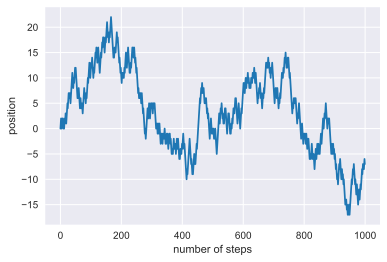

In [6]:
# Make a vector of time points.
steps = np.arange(0, n_steps, 1)  # Arange from 0 to n_steps taking intervals of 1.

# Plot it!
plt.plot(steps, position)
plt.xlabel('number of steps')
plt.ylabel('position')

Again, since our steps are based on the generation of random numbers. This trajectory will change every time you run the code. As we discussed earlier, the power of stochastic simulation comes from doing them many times over. Let's write our random walk code again one thousand times and plot all of the traces. 

In [7]:
# Perform the random walk 1000 times. 
n_simulations = 1000

# Make a new position vector. This will include all simulations.
position = np.zeros((n_simulations, n_steps))

# Redefine our step probability just to be clear. 
step_prob = 0.5

# Loop through each simulation.
for i in range(n_simulations):
    # Loop through each step. 
    for j in range(1, n_steps):
        # Flip a coin.
        flip = np.random.rand()
        
        # Figure out how to step.
        if flip < step_prob:
            step = -1
        else:
            step = 1
            
        # Update our position.
        position[i, j] = position[i, j-1] + step

You'll notice that this cell took a little bit longer to run than the previous one. This is because we are doing the simulation a thousand times over! To show the random walks, we'll plot all of the trajectories over each other as thin lines.  

In [8]:
# Plot all of the trajectories together.
for i in range(n_simulations):
    # Remembering that `position` is just a two-dimensional matrix that is 
    # n_simulations by n_steps, we can get each step for a given simulation 
    # by indexing as position[i, :].
    plt.plot(steps, position[i, :], linewidth=1, alpha=0.5) 
    
# Add axis labels.
plt.xlabel('number of steps')
plt.ylabel('position')

Text(0,0.5,'position')

Pretty cool!  We can look at the distribution of positions at various steps in time by making histograms of the positions of each simulation. Let's take a look at the distribution of positions at $t = 200$ steps.

(-100, 100)

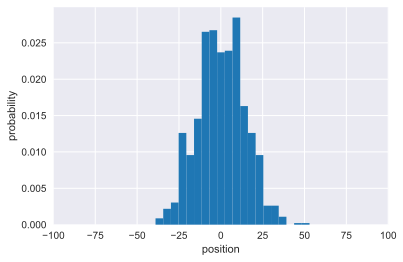

In [9]:
# Make a histogram of the positions. To look at t=200, we have to index at 
# 199 because indexing starts at 0  in Python. We'll also normalize the 
# histogram (normed=True) so we can get a measure of probability.
plt.hist(position[:, 199], bins=20, normed=True)
plt.xlabel('position')
plt.ylabel('probability')

# Set the xlimits to cover the entire range. 
plt.xlim([-100, 100])

We see that this qualitatively appears to be Gaussian. If we had to guess, we could say that the mean looks like it is right at about zero. Let's take a look at the distribution of positions at the last time point as well. 

(-100, 100)

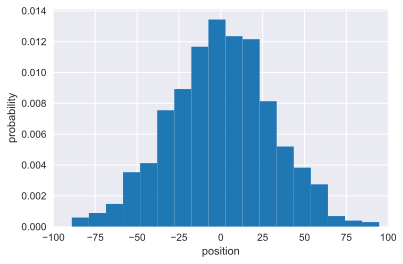

In [10]:
# Make a histogram of the position distribution at the last time step. We could
# just index at 999, but indexing at -1 will always return the distribution at
# the last time step, whatever that may be. 
plt.hist(position[:, -1], bins=20, normed=True)
plt.xlabel('position')
plt.ylabel('probability')
plt.xlim([-100, 100])

Again, this distribution looks somewhat Gaussian with a mean of approximately zero. We can actually compute the mean position from our simulation by iterating through each time step and simply computing the mean. Let's plot the mean at each time point as a red line. 

In [11]:
# Compute the mean position at each step and plot it. 
mean_position = np.zeros(n_steps)
for i in range(n_steps):
    mean_position[i] = np.mean(position[:, i])

# Plot all of the simulations.
for i in range(n_simulations):
    plt.plot(steps, position[i, :], linewidth=1, alpha=0.5)
    
# Plot the mean as a thick red line. 
plt.plot(steps, mean_position, 'r-')

# Add the labels.
plt.xlabel('number of steps')
plt.ylabel('position')

Text(0,0.5,'position')

As we will learn in a few weeks, this is exactly what we would expect. While the mean position is zero, the mean squared displacement is not quite so trivial. Let's compute this value and plot it as a function of the number of steps. 

(0, 1100)

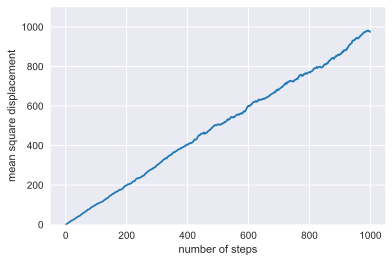

In [12]:
# Compute the mean squared displacement.
msd = np.zeros(n_steps)
for i in range(n_steps):
    msd[i] = np.mean(position[:, i]**2)

# Plot the mean squared as a function of the number of steps.
plt.plot(steps, msd)
plt.xlabel('number of steps')
plt.ylabel('mean square displacement')
plt.ylim([0, 1100])
    

That certainly looks like it scales linearly with the number of steps, just as we predicted. 


Of course, stochastic simulations are useful for far more than just playing around with diffusion. Let's take a look at a different (but behaviorally similar!) example -- the allele frequency of an evolving population. 

## Example II: The Buri experiment and Genetic Drift 

In 1956 Peter Buri, a student of
[Sewall Wright](https://en.wikipedia.org/wiki/Sewall_Wright) published the now classic paper *Gene Frequency in Small Populations of Mutant
Drosophila* in which he experimentally demonstrated the concept of genetic
drift.  The idea for this beautiful experiment is depicted in the follwing figure.

![Fig. 1](images/BuriSchematic.pdf)

Briefly, Buri began with eight female and eight male flies, all
heterozygotes of the *bw* locus. This means that all of the flies had 1
copy of the gene associated with white eyes, and one copy of the gene associated with  red eyes. The
phenotype that this combination of alleles gives is flies with orange eyes. He
then allowed the flies to reproduce, and after removing the adults, he randomly
chose 8 males and females from the next generation of offspring without looking at the eye color.
These new 8 males and 8 females were transferred to a new flask and the
procedure was repeated for 19 generations.

<div class="alert alert-info"> <left> 
#### Question
Work out what is the expected genotype frequency of
red-eyed flies, white-eyed flies and orange-eyed flies after the first
generation. (Hint: Recall that each allele is drawn from the parent's pool
**at random with replacement**. This means that to compute the frequency of
red-eyed flies you should calculate $f_{rr} = P(\text{red allele first draw})
\cdot P(\text{red allele second draw})$.

Since the offspring that made it to the next generation were chosen at random,
Buri knew that the outcome would be different if he repeated an identical
experiment in different vials. As a result, for statistical power he simultaneously tracked
107 flasks as
shown in the following figure.

![](images/BuriGenerations.pdf)

Each generation, he counted the number of red-eyed, white-eyed and orange-eyed flies he had randomly chosen.
The figure shows the outcomes for these different vials after 19
generations. Because the flies are allegedly mating at random, with each
generation there is an accumulation of fluctuations. As a result, after 19
generations, many vials contained only white-eyed or red-eyed flies, though
some vials still contained a mixture of eye colors.

Having quantified the number of red-eyed, white-eyed and orange-eyed flies Buri
was able to quantify the frequency of alleles in the population. Since none of
the alleles were dominant, he could infer the genotype  by
looking at the phenotype of the flies.

<div class="alert alert-info"> <left> 
#### Question
Write down the formula for the genotype frequencies in
terms of the eye color count.  Use the notation $N_{red}$ for the number of
red-eyed flies in a given vial, $N_{white}$ for the number of white-eyed flies in
that same vial and finally, $N_{orange}$ for the number of orange-eyed flies
in that same vial. Your task is to figure out the frequency of red ($f_r$) and white ($f_w$) alleles in a given vial given the counts of the number of red-, white- and orange-eyed flies.

The following figure summarizes the results of the experiment. By tracking alleles over time with these 107 populations exposed to the same conditions, Buri was able to observe evolution driven entirely by genetic drift! He saw how in some of the populations one of the alleles went extinct, arising from nothing more than the fluctuations inherent in small
populations.

![](images/BuriExperiment.pdf)

It is now time for us to use our computational prowess to simulate and explore the Buri experiment.

To explore the influence of genetic drift on the Buri experiment we'll use our newfound talents in stochastic simulations to track the frequencies of two alleles. To reproduce the experiment the best we can, we'll make some assumptions that are implicit in the original experimental setup. 

1. There is a set of alleles ($A$ and $a$) in the population which confer different eye color.
2. The size of the population is fixed across generations.
3. All breeding is totally random, meaning that there is no sexual selection. 
4. There is no selection or mutation.

While we'll relax point #4 later on, these stipulations will allow us to examine how drift can strongly influence evolution. To do so, we will simulate this randomly breeding population over many generations and keep track of the allele frequency of the $A$ allele. 

We can construct this simulation just like we did with a random walk with one important change.

**In a randomly breeding population, the allele frequency of one generation is dependent on its frequency in the previous generation.** This would be analogous to our coin developing a bias in our flip where the probability of 'heads' is dependent on the frequency of 'heads' obtained in the previous generation. But maybe a better analogy would be as follows: Imagine a jar with black and white marbles which represent each of the alleles. This jar will represent our toy model for random mating. On each generation we draw a marble at random, register which color was it, and then **put it back into the jar** (this means we are doing random sampling *with replacement*). If at generation $t$ you started with $N_A^{(t)}$ black marbles and $N_a^{(t)}$ white marbles, the chance of drawing a black marble was simply
$$
p_A(t) = \frac{N_A^{(t)}}{N_{tot}}
\tag{1}
$$
where $N_{tot} = N_A^{(t)} + N_a^{(t)}$ is the total number of alleles that we assume remains constant over generations. The main difference with the random walk studied above is that for the particle diffusing this $p_A(t)$ would have remained constant for each step. But for alleles in random mating this has to change according to how many black and white marbles we draw on the previous generation. This means that if we ended up with $N_A^{(t+1)}$ black marbles at generation $t+1$, the probability for the following generation would then be given by
$$
p_A(t+1) = \frac{N_A^{(t+1)}}{N_{tot}}
\tag{2}
$$

Therefore for our allele segregation simulation we will flip $N_{tot}$ coins at a time (this will speed up our simulation slightly), and update the coin bias after each simulation round.

In [17]:
# Define some parameters of the simulation.
pop_size = 16  # Number of individuals in the population.
n_alleles = 2 * pop_size  # Total number of alleles in the population. 
n_gen = 19 # Number of generations to track the allele frequencies.
freq = 0.5  # Initial allele frequency of allele A.

# Set up a vector to store the allele frequency at each generation.
frequency = np.zeros(n_gen)  # Full of zeros.

# Set the initial condition.
frequency[0] = freq

# Loop through the generations. 
for i in range(1, n_gen):
    # Flip a coin for each member of the population.
    flips = np.random.rand(n_alleles)
    
    # Determine if each allele is 'A' or 'a' based on the frequency from
    # the previous generation.
    num_A = np.sum(flips < frequency[i-1])
    
    # Determine the new allele frequency.
    new_freq = num_A / n_alleles
    
    # Store the new allele frequency.
    frequency[i] = new_freq

As we did in the random walk, let's take a look at the trajectory of this single population. 

(0, 1)

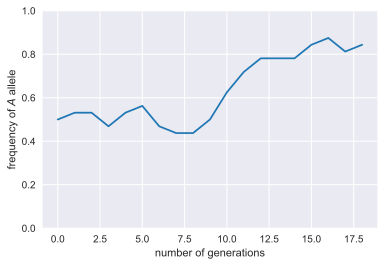

In [18]:
# Set up a vector for the number of generations.
gen_vec = np.arange(0, n_gen, 1)

# Plot this single trajectory.
plt.plot(gen_vec, frequency)

# Add axis labels.
plt.xlabel('number of generations')
plt.ylabel('frequency of $A$ allele')

# Change the ylimits to cover the full range of possible frequencies.
plt.ylim([0, 1])

Again, as this is a stochastic simulation, the trajectory will look different each time we run the simulation. Notice that in most simulations, the allele frequency goes to either 1.0 or 0.0. At this point, the allele is **fixed** meaning that there are no other copies of the allele available for breeding. Every once in a while, you'll see a trajectory that doesn't reach fixation. 

As we saw in the example of the random walk, it's difficult to get a feeling for a stochastic process by looking at only one example. Let's expand this simulation to examine the behavior of multiple vials with flies. 

In [19]:
# Expand the simulation to cover all 5 recovering vials of bison. 
n_vials = 107
frequency = np.zeros((n_vials, n_gen))

# Loop through each herd and repeat the simulation.
for i in range(n_vials):
    # Set the initial frequency.
    frequency[i, 0] = 0.5
    for j in range(1, n_gen):
        # Flip the coins.
        flips = np.random.rand(n_alleles)
        
        # Find the number of 'A' alleles.
        num_A = np.sum(flips < frequency[i, j-1])
        
        # Determine the new frequency
        new_freq = num_A / n_alleles
        
        # Set the current allele frequency.
        frequency[i, j] = new_freq


Let's plot 'em!

(0, 1)

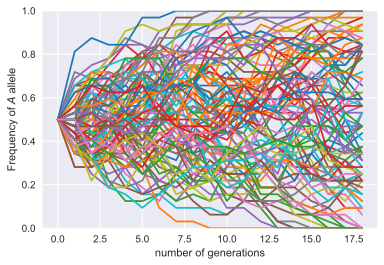

In [20]:
# Plot the trajectories from all of the vials.
for i in range(n_vials):
    plt.plot(gen_vec, frequency[i, :])
    
# Add axis labels.
plt.xlabel('number of generations')
plt.ylabel('Frequency of $A$ allele')
plt.ylim([0, 1])

We can see that some populations reached fixation of 1.0, some 0.0, and one of them didn't reach fixation at all. 

## Quantifying average time to fixation of an allele

Now that we have seen the outcome of multiple simulations an interesting question is how does the population size affect the allele dynamics? Intuitively one could think that the larger the population, the more difficult it is to reach one of the absorbing boundaries. But rather than giving intuitive arguments, let's just use the code we have generated so far to address this question!

We will now repeat the simulation for the 107 populations, this time extending it to 1000 generations. We will then quantify the time it takes for each of these populations to have one of the alleles fixed, i.e. we will find the time point for each population at which the allele frequency becomes either zero or one, and save that generation number at which this happened.

But before jumping to multiple generations let us use the exact same simulation code as before to figure out how to use the function `np.where` to find the fixation time for a single population.

Let's run the simulation for 1000 generations and plot it.

(0, 1)

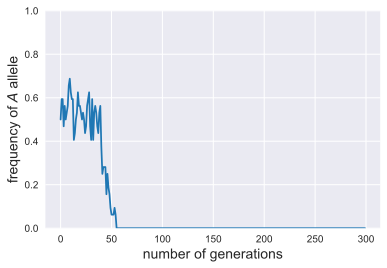

In [21]:
# Define some parameters of the simulation.
pop_size = 16 # Number of individuals in the population.
n_alleles = 2 * pop_size  # Total number of alleles in the population. 
n_gen = 300 # Number of generations to track the allele frequencies.
freq = 0.5  # Allele frequency of the 'A' allele.

# Set up a vector to store the allele frequency at each generation.
frequency = np.zeros(n_gen)  # Full of zeros.

# Set the initial condition.
frequency[0] = freq

# Loop through the generations. 
for i in range(1, n_gen):
    # Flip a coin for each member of the population.
    flips = np.random.rand(n_alleles)
    
    # Determine if each allele is 'A' or 'a' based on the frequency from
    # the previous generation.
    num_A = np.sum(flips < frequency[i-1])
    
    # Determine the new allele frequency.
    new_freq = num_A / n_alleles
    
    # Store the new allele frequency.
    frequency[i] = new_freq

# Set up a vector for the number of generations.
gen_vec = np.arange(0, n_gen, 1)

# Plot this single trajectory.
plt.plot(gen_vec, frequency)

# Add axis labels.
plt.xlabel('number of generations', fontsize=14)
plt.ylabel('frequency of $A$ allele', fontsize=14)

# Change the ylimits to cover the full range of possible frequencies.
plt.ylim([0, 1])

Now that we have the vector containing the gene frequencies let's use np.where to find when does the frequency go to either 0 **or** 1. Note that we highlighted the or statement since we will make use of a boolean or operation to include both possibilities.

All we need is to find where does the frequency is either 0 or 1 and locate the smaller index at which this happens. This would indicate the generation where the fixation happened.

In [22]:
# Locate all the indices where one of the alleles was fixed in the population.
# The or boolean operation is indicated with the vertical bar |.
fix_gen = np.where((frequency==1) | (frequency==0))
# Let's print the generation at which fixation happens which should be the
# minimum index at which either of these conditions is satisfied. For this we
# will use the np.min function
print(' One of alleles was fixed at generation:', np.min(fix_gen))

 One of alleles was fixed at generation: 55


Now that we know how to compute the generation at which fixation happens we can repeat this for 100 populations and register this fixation time. Since we are going to be continuously changing the population size and repeating the simulation is better if we define a function that performs all this computation.

To do this we are going to define 2 functions:

1. The first one will perform the simulation for n_pop populations and return a matrix where each row tracks the allele frequency on each of these populations just as in the tutorial.
2. The second function will take as an input this matrix and will loop through each row (i.e. each population) finding where did fixation of an allele first happened.

In [23]:
def stochastic_sim_drift(pop_size, n_gen, init_freq, n_pop):
    '''
    Performs a stochastic simulation of allele segregations with drift and
    mutation as the evolutionary forces.
    Paremeters
    ----------
    pop_size : int.
        population size in the simulation
    n_gen : int.
        number of generations to run the simulation
    init_freq : float [0, 1]
        initial frequency in the population
    n_pop : int.
        number of populations to run in parallel
    
    Returns
    -------
    a n_pop x n_gen matrix with the simulations for each population.
    '''
    # number of alleles for diploid organisms
    n_alleles = 2 * pop_size 
    
    # Initialize matrix to save outcomes of simulation. This matrix should
    # have n_pop rows and n_gen columns.
    frequency = np.zeros([n_pop, n_gen])
    
    # Loop through each population and repeat the simulation.
    for i in range(n_pop):
        # Set the initial frequency.
        frequency[i, 0] = init_freq
        for j in range(1, n_gen):
            # Flip a coin for each member of the population.
            flips = np.random.rand(n_alleles)

            # Determine if each allele is 'A' or 'a' based on the frequency from
            # the previous generation.
            num_A = np.sum(flips < frequency[i, j-1])
            
            # Determine the new allele frequency.
            new_freq = num_A / n_alleles

            # Store the new allele frequency.
            frequency[i, j] = new_freq
    
    # Make the function return the frequency matrix as output
    return frequency

Now let's define the second function to find the fixation time.

In [24]:
def fix_time(sim_mat):
    '''
    Given a simulation matrix sim_mat finds the generation at which one of the
    alleles is fixed in each of the populations.
    Parameters
    ----------
    sim_mat : array-like
        Simulation matrix in which each row represents one population and each
        column represent one generation
        
    Returns
    -------
    array-like object with the fixation times for each generation
    '''
    # Initialize array to save each fixation time
    fix_array = np.zeros(np.shape(sim_mat)[0])
    
    # Loop through each of the rows to find the fixation time
    for i, pop in enumerate(sim_mat):
        fix_array[i] = np.min(np.where((pop==0) | (pop==1)))
        
    return fix_array

Having define these functions now we can very easily run the simulation for different population sizes.

Let's first test the functions by performing a simulation with the same population size as the Buri experiment and plotting the distribution of fixation times.

In [25]:
# Define parameters for simulation
pop_size = 16 
n_gen = 1000 # number of generations
freq = 0.5 # initial frequency of the population
n_pop = 107 # number of populations

# Run the simulation
sim_mat = stochastic_sim_drift(pop_size, n_gen, freq, n_pop)

# Find the fixation time for each population
fix = fix_time(sim_mat)

Let's now plot the histogram of fixation times and we will draw a vertical line where the mean fixation time is.

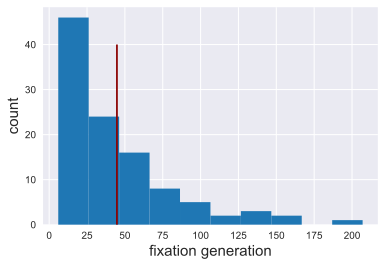

In [26]:
# Plot the histogram
plt.hist(fix)
# Include a vertical line indicating the mean. This is done with the function
# vlines where the first entry is the x position where the line should be and
# the second and third entry indicate the ymin and ymax extent for the line
plt.vlines(np.mean(fix), 0, 40, color='darkred')
# label axis
plt.xlabel('fixation generation', fontsize=15)
_ = plt.ylabel('count', fontsize=15)

So we can perform the simulation and compute the mean time to fixation. Let's now repeat this for different population sizes, saving this mean fixation time on every iteration.

In [27]:
# Define parameters for simulation
pop_size = [4, 8, 16, 32, 64] # number of flies per vial
n_gen = 1000 # number of generations
freq = 0.5 # initial frequency of the population
n_pop = 107 # number of vials.

# Initialize array to save the mean fixation time. The function np.zeros_like
# generates an array of only zeroes of the same shape as the array given as 
# input
fix_array = np.zeros_like(pop_size)

# Loop through each population size, run the simulation and save the mean
# fixation time
for i in range(len(pop_size)):
    # Run the simulation with our fancy function
    sim_mat = stochastic_sim_drift(pop_size[i], n_gen, freq, n_pop)
    # Find the fixation time for each population with the other fancy function
    fix = fix_time(sim_mat)
    # Save the mean fixation time
    fix_array[i] = np.mean(fix)

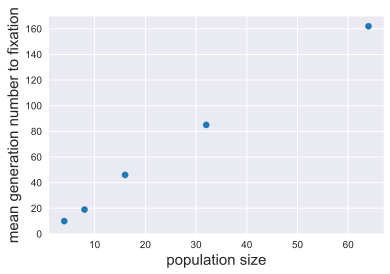

In [28]:
# We want to plot the mean fixation time as a function of population size. For
# this we will use the function plt.scatter that makes a scatter plot given an 
# array of x and y coordinates. 
# -> marker='o' indicates the type of symbol we want for our scatter plot
# -> s=40 indicates the size of the symbol
plt.scatter(pop_size, fix_array, marker='o', s=40)

# Label the axis
plt.xlabel('population size', fontsize=15)
plt.ylabel('mean generation number to fixation', fontsize=15)

# Set the bottom y limit to be zero
_= plt.ylim(bottom=0)

Our intuition was not only right, but it was literally the right answer. The time to fixation for an allele not only scales with population size, but it does it in a linear fashion!